# Computer Vision. Sentinel-2 image matching problem
## by Oleh Buravenko

15 Nov. 2024

In this notebook, we will consider contemporary image matching possibilities on satellite geographical pictures. In this case, we used methods such as the SIFT algorithm for detecting and describing image features, BFMatcher for keypoints matching between two images, and the RANSAC algorithm to eliminate incorrect matches. The algorithm is supposed to find matches between images from different seasons. Let's dive in!

Firstly, we have to get an appropriate well-built dataset. In our case, we used Deforestation in Ukraine dataset from Sentinel2 data by Quantum
Link: https://www.kaggle.com/datasets/isaienkov/deforestation-in-ukraine

In [ ]:
#Use this command to download to your directory
!kaggle datasets download isaienkov/deforestation-in-ukraine

In [2]:
#Next, let's install the necessary libs, but if you use Google Colab, they might be already installed
!pip install numpy pandas matplotlib seaborn scikit-learn tensorflow torch torchvision keras xgboost lightgbm catboost opencv-python pillow h5py joblib tqdm opendatasets rasterio geopandas shapely

In [4]:
#Import the libs
import numpy as np
import pandas as pd
import cv2
import matplotlib.pyplot as plt
import os
import rasterio
from rasterio.plot import reshape_as_image
import rasterio.mask
from rasterio.features import rasterize
import pandas as pd
import geopandas as gpd
from shapely.geometry import mapping, Point, Polygon
from shapely.ops import cascaded_union
import glob

Now that we've downloaded the dataset archive and imported the libraries, we need to extract it.

In [ ]:
import zipfile

# Define the path to your zip file and the target extraction directory
zip_file_path = "D:/content/archive.zip" # Your path can be different
extract_to = "D:/content/deforestation-in-ukraine"

# Open and extract all files
with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
    zip_ref.extractall(extract_to)

print("Extraction complete.")

After successfully extracting the dataset, we will use the Geopandas library to read the dataset from there.

In [5]:
df = gpd.read_file('D:/content/deforestation-in-ukraine/deforestation_labels.geojson')
df

,img_date,tile,geometry
0,2016-04-09,36UXA,"POLYGON ((35.79130 50.17406, 35.79277 50.17354..."
1,2016-04-09,36UXA,"POLYGON ((35.77653 50.10271, 35.77810 50.10318..."
2,2016-04-09,36UXA,"POLYGON ((35.78621 50.01277, 35.78616 50.01369..."
3,2016-04-09,36UXA,"POLYGON ((35.78007 50.00556, 35.78189 50.00557..."
4,2016-04-09,36UXA,"POLYGON ((35.79781 49.99568, 35.79908 49.99582..."
...,...,...,...
5691,2019-09-09,36UYA,"POLYGON ((36.37494 50.17378, 36.37506 50.17376..."
5692,2019-09-09,36UYA,"POLYGON ((36.37849 50.17354, 36.37851 50.17352..."
5693,2019-09-09,36UYA,"POLYGON ((35.91477 50.22407, 35.91472 50.22394..."
5694,2019-10-26,36UYA,"POLYGON ((36.88312 50.26589, 36.88408 50.26489..."


We will try to extract the first image from the dataset and convert it to the appropriate format from JP2, and then check its shape and appearance.

In [6]:
# Getting the first image from our directory
raster_path = "D:/content/deforestation-in-ukraine/S2A_MSIL1C_20160212T084052_N0201_R064_T36UYA_20160212T084510/S2A_MSIL1C_20160212T084052_N0201_R064_T36UYA_20160212T084510.SAFE/GRANULE/L1C_T36UYA_A003350_20160212T084510/IMG_DATA/T36UYA_20160212T084052_B02.jp2"


ds_path = "D:/content/deforestation-in-ukraine"
pattern = os.path.join(ds_path, '**', 'IMG_DATA', '*_TCI.jp2')
image_paths = glob.glob(pattern, recursive=True)
with rasterio.open(image_paths[0], "r", driver="JP2OpenJpeg") as src:
    raster_img = src.read()
    raster_meta = src.meta

# Reshaping image in appropriate format using lib's inbuilt function
raster_img = reshape_as_image(raster_img)
raster_img.shape

(10980, 10980, 3)

Next, we need to analyze more images in the dataset to select a suitable pair for matching, ideally all of them. We will also preprocess them accordingly to optimize our algorithm's performance. It is important to note that the sizes of the images are very large, so we will reduce their size to 2048x2048, which I believe is the optimal size, as smaller sizes might lead to even greater information loss. 
Additionally, we will use Gaussian Blur and Normalization to prevent possible image distortion and preserve details for keypoint detection.

In [7]:
# Defining dataset's path
ds_path = "D:/content/deforestation-in-ukraine"

In [8]:
def extract_and_preprocess_images(ds_path, num=5, max_dimension=2048):
    images = []
    count = 0
    
    # Update the pattern to match only files ending with '_TCI.jp2'
    pattern = os.path.join(ds_path, '**', 'IMG_DATA', '*_TCI.jp2')
    image_paths = glob.glob(pattern, recursive=True)
    
    # If requested number is larger than available images, use all available images
    num = min(num, len(image_paths))
    
    for image_path in image_paths[:num]:
        # Load the image using rasterio
        with rasterio.open(image_path, "r", driver="JP2OpenJpeg") as src:
            image = src.read() 
            image = reshape_as_image(image)

        height, width, _ = image.shape
        scale = max_dimension / max(height, width)
        new_size = (int(width * scale), int(height * scale))
        
        image_blur = cv2.GaussianBlur(image, (3, 3), 0)
        image_resized = cv2.resize(image_blur, new_size, interpolation=cv2.INTER_CUBIC)
        image_normalized = cv2.normalize(image_resized, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX)
        
        images.append(image_normalized)
        count += 1

    return images


In [9]:
images = extract_and_preprocess_images(ds_path, 50) # The preprocess will take a little over 10 mins


In [10]:
len(images)

50

Let's see which images are displayed, also outputting their index for convenience.

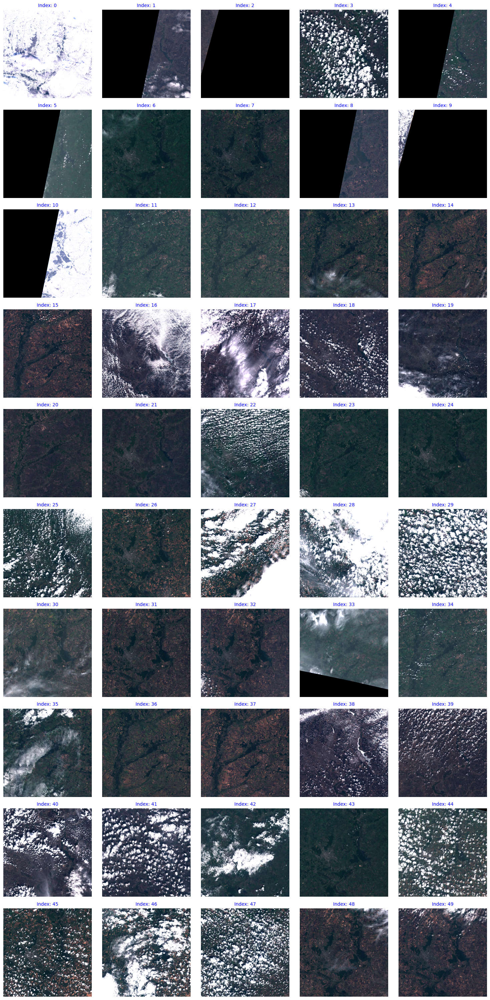

In [11]:
import math

def display_images_grid(images, images_per_row=5):

    num_images = len(images)
    num_rows = math.ceil(num_images / images_per_row)
    
    fig, axes = plt.subplots(num_rows, images_per_row, figsize=(15, 3 * num_rows))
    axes = axes.flatten()

    for idx, (ax, image) in enumerate(zip(axes, images)):
        ax.imshow(image, cmap='gray') 
        ax.axis('off') 
        ax.set_title(f"Index: {idx}", fontsize=10, color='blue')

    for ax in axes[num_images:]:
        ax.axis('off')

    plt.tight_layout()
    plt.show()
    
display_images_grid(images)

So, let's import the necessary algorithm functions where we will determine key points using SIFT, match them, and use the RANSAC algorithm to filter out incorrect matches.

In [1]:
import image_matching_algorithm # The file must be in the same directory as the notebook

In [1]:
from image_matching_algorithm import compute_keypoints, match_images, ransac_filter, visualize_keypoints_matches, visualize_keypoints_matches_without_ransac

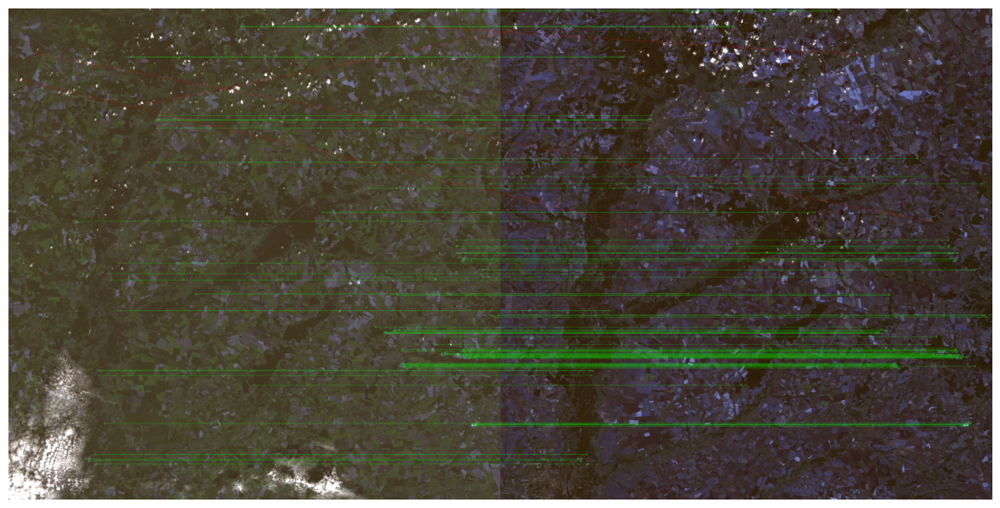

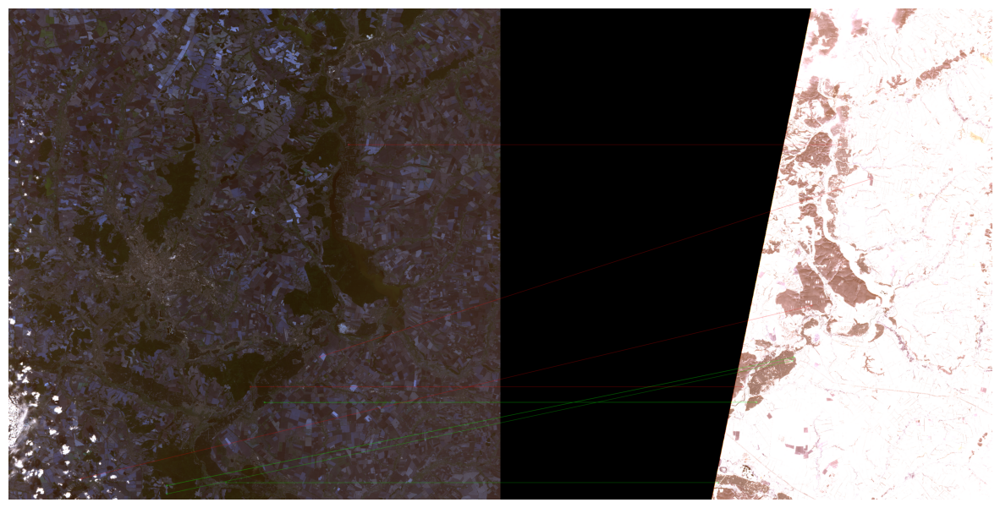

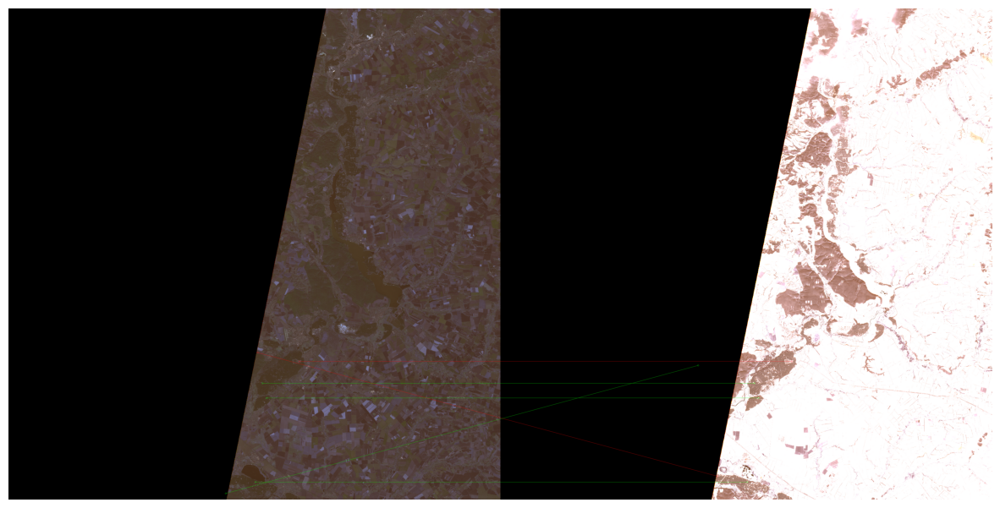

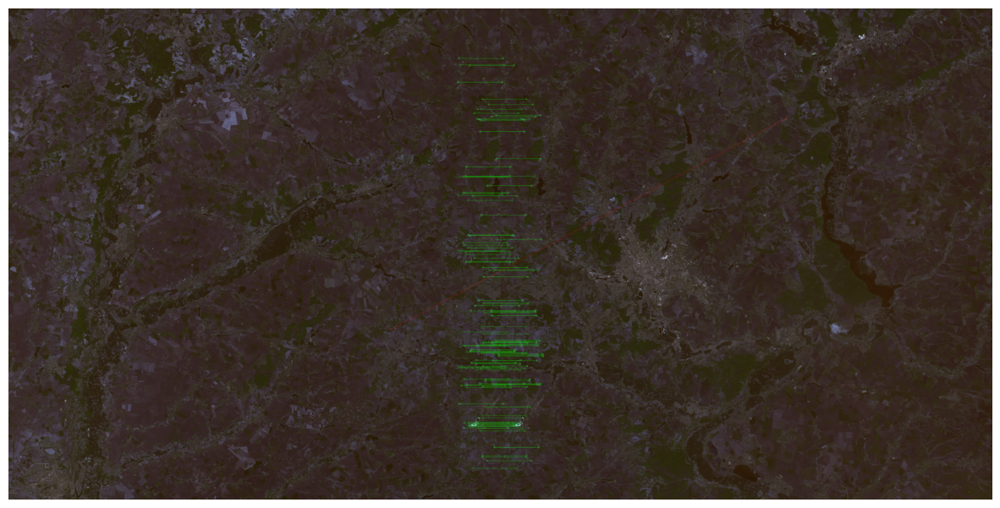

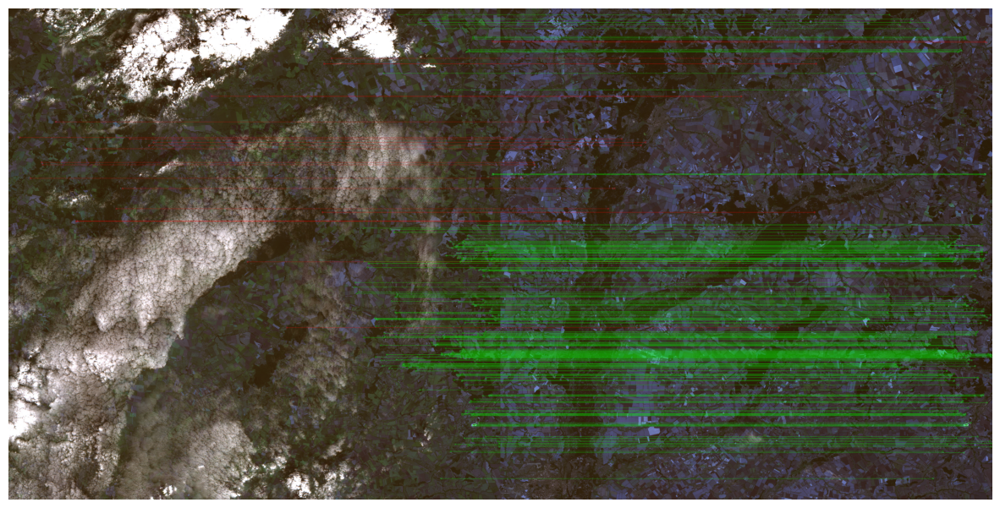

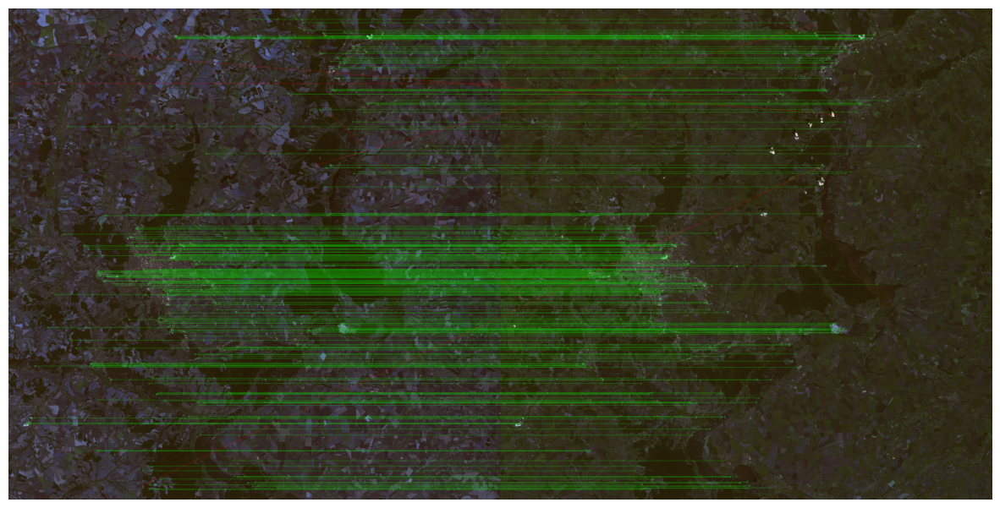

In [12]:
image_pairs = [[images[11], images[15]], [images[32], images[10]], [images[8], images[10]], [images[20], images[21]], [images[35], images[37]], [images[31], images[43]]]


for image_pair in image_pairs:
    left = image_pair[0]
    right = image_pair[1]
    
    # Extracting keypoints and descriptors of both images for our Matcher
    keypoints1, descriptors1, keypoints2, descriptors2 = compute_keypoints(image_pair)
    # Matching images using descriptors and setting a threshold for matches quantity regulation
    matches = match_images(descriptors1, descriptors2, 0.6) # threshold with the least wrong matches 
    # Using RANSAC to highlight odd matches
    inliers, outliers = ransac_filter(matches, keypoints1, keypoints2)
    visualize_keypoints_matches(left, right, keypoints1, keypoints2, inliers, outliers)

As can be seen from the first pair of images, our algorithm has fully accomplished its task since the matches are parallel between the photographs, with only a small portion of matches marked in red by the RANSAC algorithm, indicating incorrect matches, as the images are not rotated and are in the same position regardless of the season. We can also observe the last pair of images, where the left one is partially distorted by clouds, but the other half is more visible, allowing the algorithm to better identify this part of the similarities. It's also worth highlighting the fourth pair of images, which are different but have similarities in the middle, suggesting that the left location was photographed with part of the right location.

However, it's important to note that we can adjust the threshold for the number of matches to generate, and by setting the threshold, we can select only good matches. Therefore, we will set a threshold of 0.4.

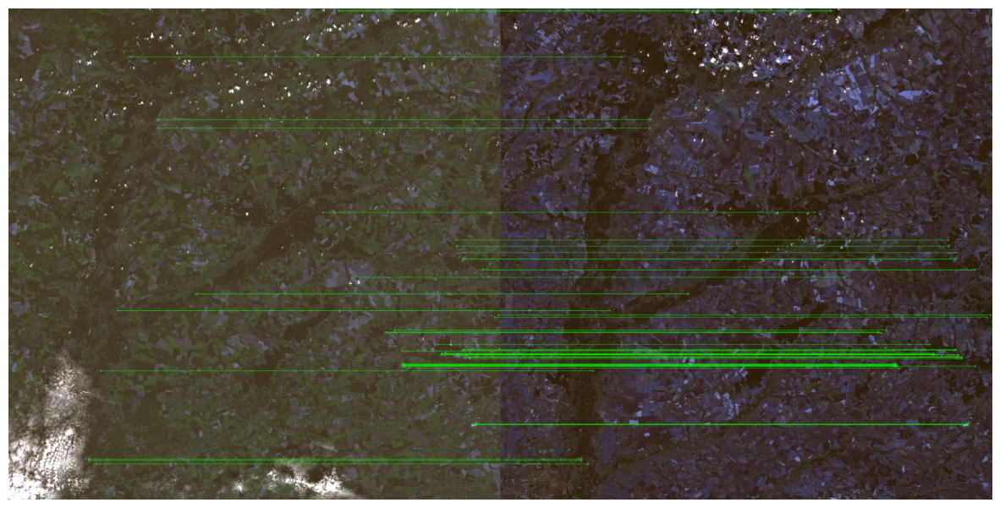

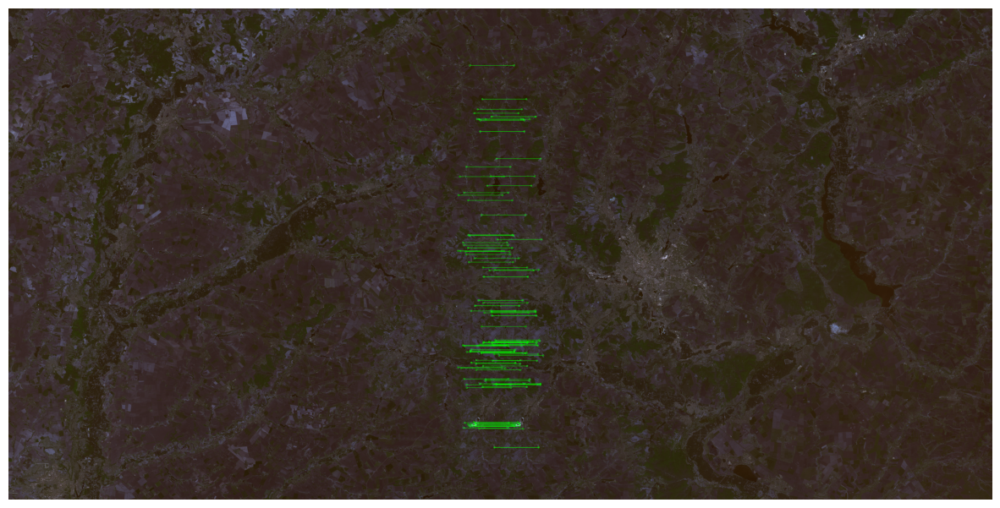

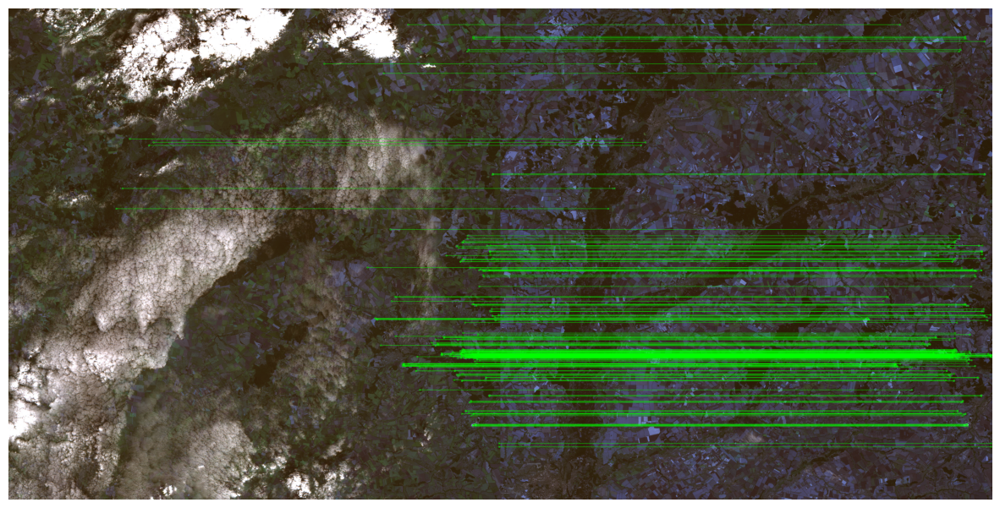

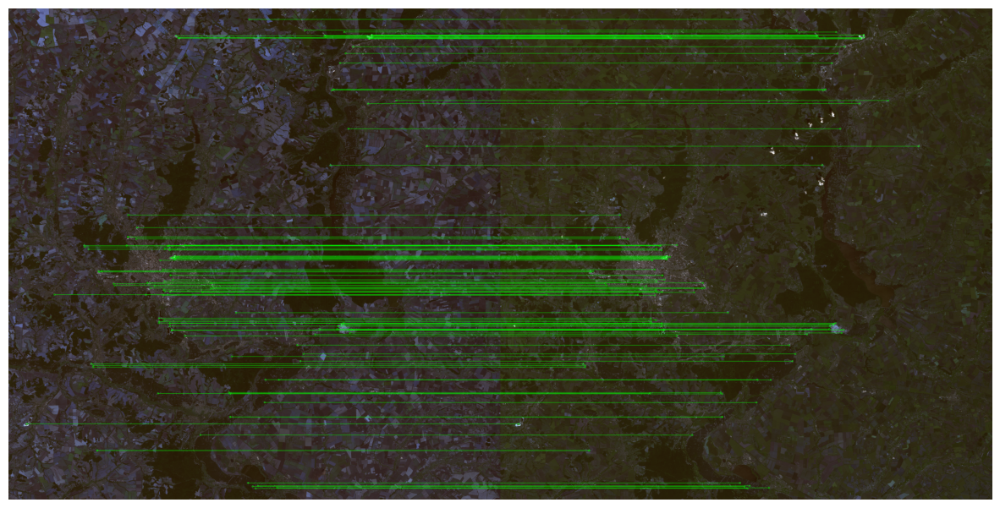

In [13]:
image_pairs = [[images[11], images[15]], [images[20], images[21]], [images[35], images[37]], [images[31], images[43]]]


for image_pair in image_pairs:
    left = image_pair[0]
    right = image_pair[1]

    keypoints1, descriptors1, keypoints2, descriptors2 = compute_keypoints(image_pair)
    matches = match_images(descriptors1, descriptors2, 0.4) # threshold with the least wrong matches 
    visualize_keypoints_matches_without_ransac(left, right, keypoints1, keypoints2, matches)

In conclusion, even in this case, we can achieve a good correlation between the pair of images.